# Train and Test the SpaceNet 7 Baseline Algorithm

### Project Members:

Muhammad Abu Bakr – 21030017

Muhammad Ahmed Hussain Wyne – 23100112

We have chosen XD_XD network for doing instance segmentation in given satellite images. XD_XD comprises of VGG16 as an encoder and UNET as a decoder. It uses binary cross entropy with jaccard as loss function.

Following enhacements have been evaluated:

To reduce complexity, three convolution layers from VGG16 encoder were removed. This resulted in reduction of parameters from 14.7 million to 9.4 million. Not only this alleviated memory requirements but also reduced training time; now less epochs are needed to reach the same result.

In satellite images, buildings (objects to be masked) only comprise around 5 pc of the image. This poses a unique problem. Few loss functions can overcome the "all zero valley" . Incorrect predictions where none of the pixels correspond to buildings could yield 95% accuracy. To overcome this challenge, we have tried out multiple loss functions and found combination of Dice with Jaccard to be capable of yielding high-fidelity building footprints.

--------
## 3. Extract Footprints and Building Identifiers, for using BCELogitLoss+ Jaccard

The `sn7_baseline_infer.py` script executes the segmentation model, which is only the first step in the extracting matched building footprints in the data cube.  In the cells below, we refine these predictioms masks to the final output.

In [1]:
# Set prediction and image directories (edit appropriately)
pred_top_dir = '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16'
im_top_dir = '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/local_data/sn7/aws_download/test_public'

from shapely.ops import cascaded_union
import matplotlib.pyplot as plt
import geopandas as gpd
import multiprocessing
import pandas as pd
import numpy as np
import skimage.io
import tqdm
import glob
import math
import gdal
import time
import sys
import os

import matplotlib.pyplot as plt
plt.rcParams.update({'font.size': 16})
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300
import matplotlib
# matplotlib.use('Agg') # non-interactive

import solaris as sol
from solaris.utils.core import _check_gdf_load
from solaris.raster.image import create_multiband_geotiff 

# import from data_postproc_funcs
module_path = os.path.abspath(os.path.join('../src/'))
if module_path not in sys.path:
    sys.path.append(module_path)
from sn7_baseline_postproc_funcs import map_wrapper, multithread_polys, \
        calculate_iou, track_footprint_identifiers, \
        sn7_convert_geojsons_to_csv

/home/phone/miniconda3/envs/solaris/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/phone/miniconda3/envs/solaris/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/phone/miniconda3/envs/solaris/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:528: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/home/phone/miniconda3/envs/solaris/lib/pyt

--------
### 3.A. Group predictions by AOI

In [2]:
raw_name = 'raw/'
grouped_name = 'grouped/'
im_list = sorted([z for z in os.listdir(os.path.join(pred_top_dir, raw_name)) if z.endswith('.tif')])
df = pd.DataFrame({'image': im_list})
roots = [z.split('mosaic_')[-1].split('.tif')[0] for z in df['image'].values]
df['root'] = roots
# copy files
for idx, row in df.iterrows():
    in_path_tmp = os.path.join(pred_top_dir, raw_name, row['image'])
    out_dir_tmp = os.path.join(pred_top_dir, grouped_name, row['root'], 'masks')
    os.makedirs(out_dir_tmp, exist_ok=True)
    cmd = 'cp ' + in_path_tmp + ' ' + out_dir_tmp
    print("cmd:", cmd)
    os.system(cmd)    

cmd: cp /home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/raw/global_monthly_2017_07_mosaic_L15-1669E-1160N_6678_3548_13.tif /home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/grouped/L15-1669E-1160N_6678_3548_13/masks
cmd: cp /home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/raw/global_monthly_2017_08_mosaic_L15-1669E-1160N_6678_3548_13.tif /home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/grouped/L15-1669E-1160N_6678_3548_13/masks
cmd: cp /home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/raw/global_monthly_2017_09_mosaic_L15-1669E-1160N_6678_3548_13.tif /home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/grouped/L15-1669E-1160N_6678_3548_13/masks
cmd: cp /home/phone/Desktop/CS437/

cmd: cp /home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/raw/global_monthly_2018_12_mosaic_L15-1672E-1207N_6691_3363_13.tif /home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/grouped/L15-1672E-1207N_6691_3363_13/masks
cmd: cp /home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/raw/global_monthly_2018_12_mosaic_L15-1709E-1112N_6838_3742_13.tif /home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/grouped/L15-1709E-1112N_6838_3742_13/masks
cmd: cp /home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/raw/global_monthly_2018_12_mosaic_L15-1748E-1247N_6993_3202_13.tif /home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/grouped/L15-1748E-1247N_6993_3202_13/masks
cmd: cp /home/phone/Desktop/CS437/

cmd: cp /home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/raw/global_monthly_2019_09_mosaic_L15-1617E-1207N_6468_3360_13.tif /home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/grouped/L15-1617E-1207N_6468_3360_13/masks
cmd: cp /home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/raw/global_monthly_2019_09_mosaic_L15-1669E-1160N_6678_3548_13.tif /home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/grouped/L15-1669E-1160N_6678_3548_13/masks
cmd: cp /home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/raw/global_monthly_2019_09_mosaic_L15-1672E-1207N_6691_3363_13.tif /home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/grouped/L15-1672E-1207N_6691_3363_13/masks
cmd: cp /home/phone/Desktop/CS437/

--------
### 3.B. Explore predictions

mask_image.shape: (1024, 1024)
min, max, mean mask image: -24.64575 10.721779 -5.3952327


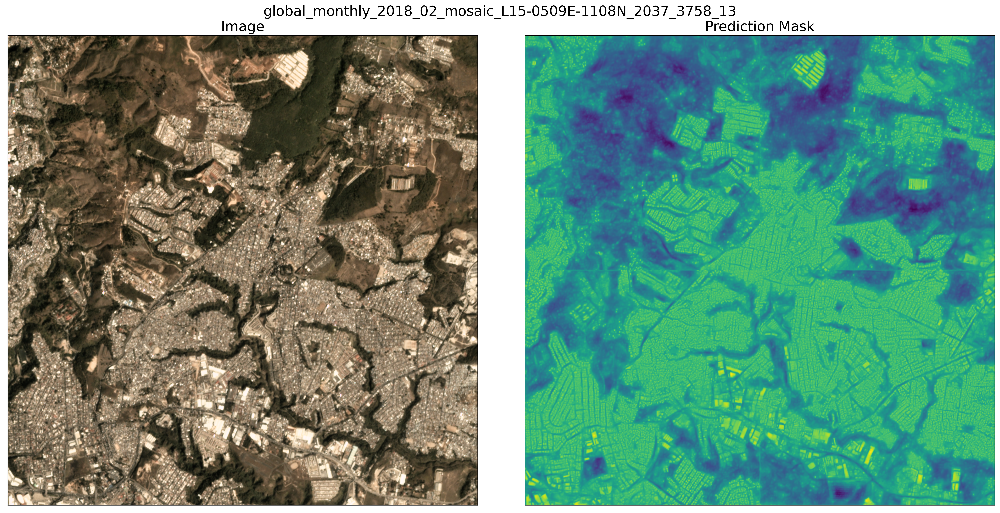

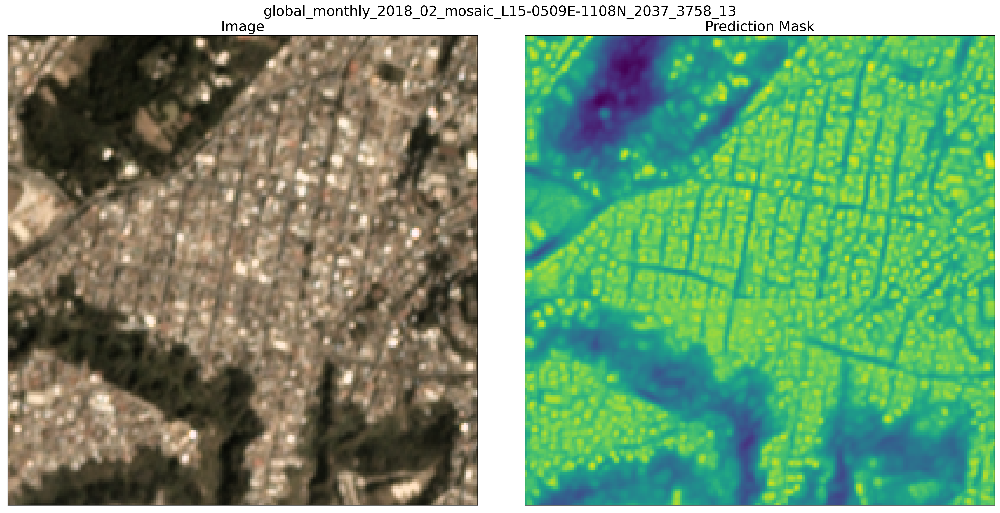

In [3]:
# Inspect visually

aoi = 'L15-0509E-1108N_2037_3758_13'
out_dir_explore = os.path.join(pred_top_dir, 'explore', aoi)
os.makedirs(out_dir_explore, exist_ok=True)

pred_dir = os.path.join(pred_top_dir, 'grouped', aoi, 'masks')
im_dir = os.path.join(im_top_dir, aoi, 'images_masked')
im_list = sorted([z for z in os.listdir(pred_dir) if z.endswith('.tif')])
sample_mask_name = im_list[0]
sample_mask_path = os.path.join(pred_dir, sample_mask_name)
sample_im_path = os.path.join(im_dir, sample_mask_name)

image = skimage.io.imread(sample_im_path)
mask_image = skimage.io.imread(sample_mask_path)
print("mask_image.shape:", mask_image.shape)
print("min, max, mean mask image:", np.min(mask_image), np.max(mask_image), np.mean(mask_image))

# # vertical layout
# figsize = (14, 14)
# fig, ax = plt.subplots(figsize=figsize)
# _ = ax.imshow(image)
# ax.set_title(sample_mask_name)
# plt.savefig(os.path.join(out_dir_explore, aoi + '_im0.png'))
# fig, ax = plt.subplots(figsize=figsize)
# _ = ax.imshow(mask_image)
# ax.set_title(sample_mask_name)
# plt.savefig(os.path.join(out_dir_explore, aoi + '_mask0.png'))
# plt.show()

# horizontal 
figsize = (20, 10)
fig, (ax0, ax1) = plt.subplots(1, 2, figsize=figsize)
_ = ax0.imshow(image)
ax0.set_xticks([])
ax0.set_yticks([])
ax0.set_title('Image')
_ = ax1.imshow(mask_image)
ax1.set_xticks([])
ax1.set_yticks([])
ax1.set_title('Prediction Mask')
plt.suptitle(sample_mask_name.split('.')[0])
plt.tight_layout()
plt.savefig(os.path.join(out_dir_explore, aoi + '_im0+mask0.png'))
plt.show()

# zoom in a subset 
# horizontal 
figsize = (20, 10)
bounds = []
fig, (ax0, ax1) = plt.subplots(1, 2, figsize=figsize)
_ = ax0.imshow(image[400:600,400:600,:])
ax0.set_xticks([])
ax0.set_yticks([])
ax0.set_title('Image')
_ = ax1.imshow(mask_image[400:600,400:600])
ax1.set_xticks([])
ax1.set_yticks([])
ax1.set_title('Prediction Mask')
plt.suptitle(sample_mask_name.split('.')[0])
plt.tight_layout()
plt.savefig(os.path.join(out_dir_explore, aoi + '_im0+mask0_zoom.png'))
plt.show()

In [4]:
# Extract and inspect sample footprints
# https://solaris.readthedocs.io/en/latest/tutorials/notebooks/api_mask_to_vector.html
# https://github.com/CosmiQ/solaris/blob/master/solaris/vector/mask.py#L718

output_path_pred = os.path.join(out_dir_explore, aoi + '_pred0.geojson')
min_area = 3.5    # in pixels
bg_threshold = 0
simplify = False
print("bg_threshold:", bg_threshold)
print("min_area:", min_area)
geoms = sol.vector.mask.mask_to_poly_geojson(mask_image, 
                                             min_area=min_area, 
                                             output_path=output_path_pred,
                                             output_type='geojson',
                                             bg_threshold=bg_threshold,
                                             simplify=simplify)
display(geoms.head())
print("N geoms:", len(geoms))

# get plot geoms
plot_geoms = cascaded_union(geoms['geometry'])
# display(plot_geoms)

bg_threshold: 0
min_area: 3.5


,geometry,value
0,"POLYGON ((77.000 0.000, 77.000 2.000, 80.000 2...",255.0
1,"POLYGON ((875.000 0.000, 875.000 2.000, 876.00...",255.0
2,"POLYGON ((880.000 0.000, 880.000 1.000, 881.00...",255.0
3,"POLYGON ((937.000 0.000, 937.000 1.000, 941.00...",255.0
4,"POLYGON ((0.000 1.000, 0.000 4.000, 2.000 4.00...",255.0


N geoms: 7332


/home/phone/miniconda3/envs/solaris/lib/python3.7/site-packages/ipykernel_launcher.py:21: ShapelyDeprecationWarning: The 'cascaded_union()' function is deprecated. Use 'unary_union()' instead.


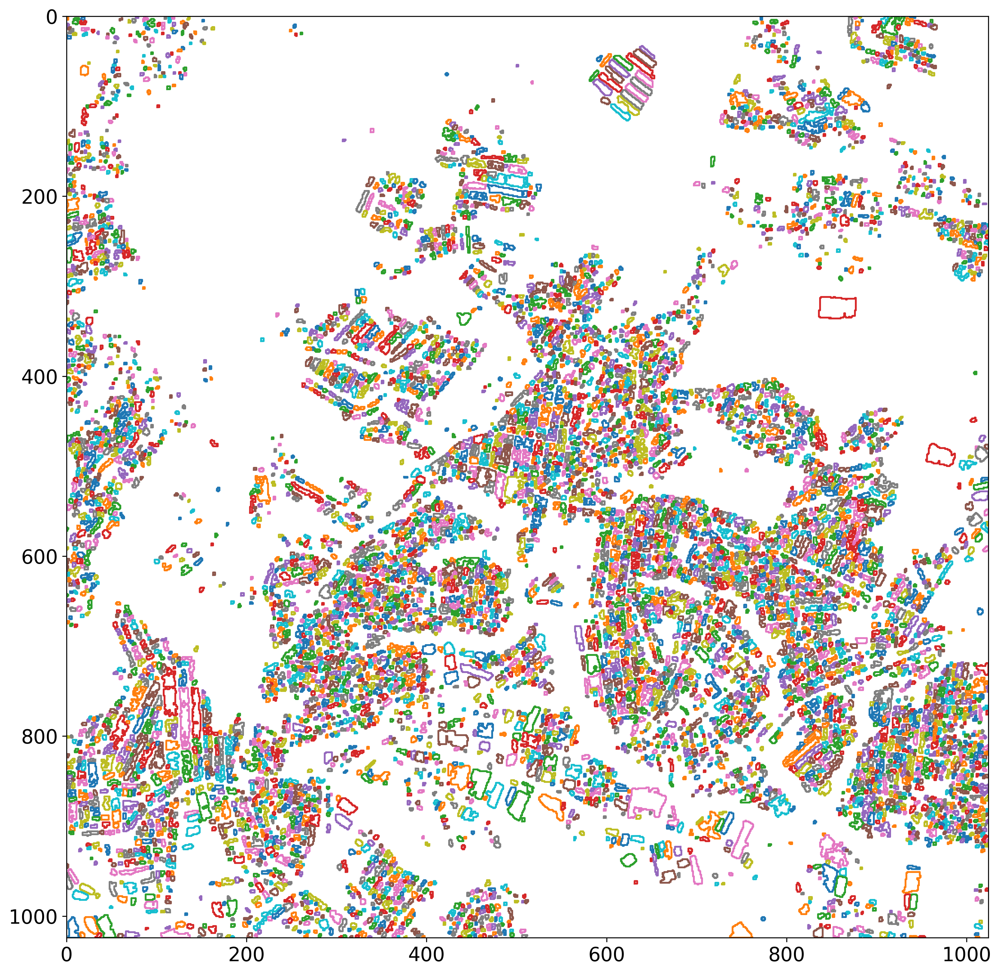

In [5]:
# Plot each polygon shape
fig, ax = plt.subplots(figsize=(14, 14))
for geom in plot_geoms.geoms:
    ax.plot(*geom.exterior.xy)
ax.set_xlim(0, mask_image.shape[1])
ax.set_ylim(mask_image.shape[1], 0)
ax.set_aspect('equal')
# Set (current) axis to be equal before showing plot?
# plt.gca().axis("equal")
plt.savefig(os.path.join(out_dir_explore, aoi + '_footprints0.png'))
plt.show()

------
## 3.C. Extract building footprint geometries for all AOIs

In [3]:
# Get all geoms for all aois (mult-threaded)

min_area = 3.5   # in pixels (4 is standard)
simplify = False
bg_threshold = 0  
output_type = 'geojson'
aois = sorted([f for f in os.listdir(os.path.join(pred_top_dir, 'grouped')) if os.path.isdir(os.path.join(pred_top_dir, 'grouped', f))])

# set params
params = []
for i, aoi in enumerate(aois):
    print(i, "/", len(aois), aoi)   
    outdir = os.path.join(pred_top_dir, 'grouped', aoi, 'pred_jsons')
    os.makedirs(outdir, exist_ok=True)
    pred_files = sorted([os.path.join(pred_top_dir, 'grouped', aoi, 'masks', f)
                for f in sorted(os.listdir(os.path.join(pred_top_dir, 'grouped', aoi, 'masks')))
                if f.endswith('.tif')])
    for j, p in enumerate(pred_files):
        name = os.path.basename(p)
        # print(i, j, name)
        output_path_pred = os.path.join(outdir,  name.split('.tif')[0] + '.geojson')
        # get pred geoms
        if not os.path.exists(output_path_pred):
            pred_image = skimage.io.imread(p)#[:,:,0]
            params.append([pred_image, min_area, output_path_pred,
                          output_type, bg_threshold, simplify])        

print("Execute!")
print("len params:", len(params))
n_threads = 10
pool = multiprocessing.Pool(n_threads)
_ = pool.map(multithread_polys, params)
## 3.C. Extract building footprint geometries for all AOIs

0 / 5 L15-1617E-1207N_6468_3360_13
1 / 5 L15-1669E-1160N_6678_3548_13
2 / 5 L15-1672E-1207N_6691_3363_13
3 / 5 L15-1709E-1112N_6838_3742_13
4 / 5 L15-1748E-1247N_6993_3202_13
Execute!
len params: 120
output_pred: global_monthly_2018_02_mosaic_L15-1617E-1207N_6468_3360_13.geojson
output_pred: global_monthly_2018_05_mosaic_L15-1617E-1207N_6468_3360_13.geojson
output_pred: global_monthly_2018_08_mosaic_L15-1617E-1207N_6468_3360_13.geojson
output_pred: global_monthly_2018_11_mosaic_L15-1617E-1207N_6468_3360_13.geojson
output_pred: global_monthly_2019_02_mosaic_L15-1617E-1207N_6468_3360_13.geojson
output_pred: global_monthly_2019_05_mosaic_L15-1617E-1207N_6468_3360_13.geojson
output_pred: global_monthly_2019_09_mosaic_L15-1617E-1207N_6468_3360_13.geojson
output_pred: global_monthly_2019_12_mosaic_L15-1617E-1207N_6468_3360_13.geojson
output_pred: global_monthly_2017_08_mosaic_L15-1669E-1160N_6678_3548_13.geojson
output_pred: global_monthly_2017_11_mosaic_L15-1669E-1160N_6678_3548_13.geojson


In [2]:
# This takes awhile, so multi-thread it

min_iou = 0.2
iou_field = 'iou_score'
id_field = 'Id'
reverse_order = False
verbose = True
super_verbose = False
n_threads = 10

json_dir_name = 'pred_jsons/'
out_dir_name = 'pred_jsons_match/'
aois = sorted([f for f in os.listdir(os.path.join(pred_top_dir, 'grouped')) 
               if os.path.isdir(os.path.join(pred_top_dir, 'grouped', f))])
print("aois:", aois)

print("Gather data for matching...")
params = []
for aoi in aois:
    print(aoi)
    json_dir = os.path.join(pred_top_dir, 'grouped', aoi, json_dir_name)
    out_dir = os.path.join(pred_top_dir, 'grouped', aoi, out_dir_name)
    
    # check if we started matching...
    if os.path.exists(out_dir):
        # print("  outdir exists:", outdir)
        json_files = sorted([f
                for f in os.listdir(os.path.join(json_dir))
                if f.endswith('.geojson') and os.path.exists(os.path.join(json_dir, f))])
        out_files_tmp = sorted([z for z in os.listdir(out_dir) if z.endswith('.geojson')])
        if len(out_files_tmp) > 0:
            if len(out_files_tmp) == len(json_files):
                print("Dir:", os.path.basename(out_dir), "N files:", len(json_files), 
                      "directory matching completed, skipping...")
                continue
            elif len(out_files_tmp) != len(json_files):
                # raise Exception("Incomplete matching in:", out_dir, "with N =", len(out_files_tmp), 
                #                 "files (should have N_gt =", 
                #                 len(json_files), "), need to purge this folder and restart matching!")
                print("Incomplete matching in:", out_dir, "with N =", len(out_files_tmp), 
                                "files (should have N_gt =", 
                                len(json_files), "), purging this folder and restarting matching!")
                purge_cmd = 'rm -r ' + out_dir
                print("  purge_cmd:", purge_cmd)
                if len(out_dir) > 20:
                    purge_cmd = 'rm -r ' + out_dir
                else:
                    raise Exception("out_dir too short, maybe deleting something unintentionally...")
                    break
                os.system(purge_cmd)
            else:
                pass

    params.append([track_footprint_identifiers, json_dir,  out_dir, min_iou, 
                   iou_field, id_field, reverse_order, verbose, super_verbose])    

print("Len params:", len(params))

aois: ['L15-1617E-1207N_6468_3360_13', 'L15-1669E-1160N_6678_3548_13', 'L15-1672E-1207N_6691_3363_13', 'L15-1709E-1112N_6838_3742_13', 'L15-1748E-1247N_6993_3202_13']
Gather data for matching...
L15-1617E-1207N_6468_3360_13
Dir:  N files: 23 directory matching completed, skipping...
L15-1669E-1160N_6678_3548_13
Dir:  N files: 26 directory matching completed, skipping...
L15-1672E-1207N_6691_3363_13
Dir:  N files: 24 directory matching completed, skipping...
L15-1709E-1112N_6838_3742_13
Dir:  N files: 22 directory matching completed, skipping...
L15-1748E-1247N_6993_3202_13
Dir:  N files: 25 directory matching completed, skipping...
Len params: 0


In [4]:
print("Execute!")
n_threads = 10
pool = multiprocessing.Pool(n_threads)
_ = pool.map(map_wrapper, params)

Execute!


In [3]:
aois

['L15-1617E-1207N_6468_3360_13',
 'L15-1669E-1160N_6678_3548_13',
 'L15-1672E-1207N_6691_3363_13',
 'L15-1709E-1112N_6838_3742_13',
 'L15-1748E-1247N_6993_3202_13']

In [7]:
# Make proposal csv

out_dir_csv = os.path.join(pred_top_dir, 'csvs')
os.makedirs(out_dir_csv, exist_ok=True)
prop_file = os.path.join(out_dir_csv, 'sn7_baseline_predictions.csv')

aoi_dirs = sorted([os.path.join(pred_top_dir, 'grouped', aoi, 'pred_jsons_match') \
                   for aoi in os.listdir(os.path.join(pred_top_dir, 'grouped')) \
                   if os.path.isdir(os.path.join(pred_top_dir, 'grouped', aoi, 'pred_jsons_match'))])
print("aoi_dirs:", aoi_dirs)

# Execute
if not os.path.exists(prop_file):
    net_df = sn7_convert_geojsons_to_csv(aoi_dirs, prop_file, 'proposal')

print("prop_file:", prop_file)

aoi_dirs: ['/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/grouped/L15-1617E-1207N_6468_3360_13/pred_jsons_match', '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/grouped/L15-1669E-1160N_6678_3548_13/pred_jsons_match', '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/grouped/L15-1672E-1207N_6691_3363_13/pred_jsons_match', '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/grouped/L15-1709E-1112N_6838_3742_13/pred_jsons_match', '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/grouped/L15-1748E-1247N_6993_3202_13/pred_jsons_match']
prop_file: /home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/csvs/sn7_baseline_predictions.csv


In [20]:
os.listdir(im_top_dir)

['L15-1669E-1160N_6678_3548_13',
 'L15-1709E-1112N_6838_3742_13',
 'L15-1617E-1207N_6468_3360_13',
 'L15-1748E-1247N_6993_3202_13',
 'L15-1672E-1207N_6691_3363_13',
 'L15-1691E-1211N_6764_3347_13',
 'L15-1669E-1160N_6679_3549_13',
 'L15-1716E-1211N_6864_3345_13',
 'L15-1690E-1211N_6763_3346_13',
 'L15-1848E-0793N_7394_5018_13',
 'L15-1669E-1153N_6678_3579_13',
 'L15-1703E-1219N_6813_3313_13']

In [6]:
# testpath =os.path.join(im_top_dir,aois[0])
label_paths = [os.path.join(im_top_dir, aoi) for aoi in aois]
display(label_paths)

['/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/local_data/sn7/aws_download/test_public/L15-1617E-1207N_6468_3360_13',
 '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/local_data/sn7/aws_download/test_public/L15-1669E-1160N_6678_3548_13',
 '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/local_data/sn7/aws_download/test_public/L15-1672E-1207N_6691_3363_13',
 '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/local_data/sn7/aws_download/test_public/L15-1709E-1112N_6838_3742_13',
 '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/local_data/sn7/aws_download/test_public/L15-1748E-1247N_6993_3202_13']

In [5]:
# # Make proposal csv

# out_dir_csv = os.path.join(pred_top_dir, 'csvs')
# os.makedirs(out_dir_csv, exist_ok=True)
# prop_file = os.path.join(out_dir_csv, 'sn7_truths.csv')

# aoi_dirs = sorted([os.path.join(im_top_dir, aoi, 'labels_match_pix') \
#                    for aoi in os.listdir(os.path.join(im_top_dir)) \
#                    if os.path.isdir(os.path.join(im_top_dir, aoi, 'labels_match_pix'))])
# print("aoi_dirs:", aoi_dirs)

# # Execute
# if not os.path.exists(prop_file):
#     net_df = sn7_convert_geojsons_to_csv(aoi_dirs, prop_file, 'proposal')

# print("prop_file:", prop_file)

In [6]:
im_top_dir

'/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/local_data/sn7/aws_download/test_public'

------
## 3.C. Extract building footprint geometries for all AOIs

In [3]:
# Get all geoms for all aois (mult-threaded)

min_area = 3.5   # in pixels (4 is standard)
simplify = False
bg_threshold = 0  
output_type = 'geojson'
aois = sorted([f for f in os.listdir(os.path.join(im_top_dir, 'grouped')) if os.path.isdir(os.path.join(pred_top_dir, 'grouped', f))])

# set params
params = []
for i, aoi in enumerate(aois):
    print(i, "/", len(aois), aoi)   
    outdir = os.path.join(pred_top_dir, 'grouped', aoi, 'pred_jsons')
    os.makedirs(outdir, exist_ok=True)
    pred_files = sorted([os.path.join(pred_top_dir, 'grouped', aoi, 'masks', f)
                for f in sorted(os.listdir(os.path.join(pred_top_dir, 'grouped', aoi, 'masks')))
                if f.endswith('.tif')])
    for j, p in enumerate(pred_files):
        name = os.path.basename(p)
        # print(i, j, name)
        output_path_pred = os.path.join(outdir,  name.split('.tif')[0] + '.geojson')
        # get pred geoms
        if not os.path.exists(output_path_pred):
            pred_image = skimage.io.imread(p)#[:,:,0]
            params.append([pred_image, min_area, output_path_pred,
                          output_type, bg_threshold, simplify])        

print("Execute!")
print("len params:", len(params))
n_threads = 10
pool = multiprocessing.Pool(n_threads)
_ = pool.map(multithread_polys, params)
## 3.C. Extract building footprint geometries for all AOIs

0 / 5 L15-1617E-1207N_6468_3360_13
1 / 5 L15-1669E-1160N_6678_3548_13
2 / 5 L15-1672E-1207N_6691_3363_13
3 / 5 L15-1709E-1112N_6838_3742_13
4 / 5 L15-1748E-1247N_6993_3202_13
Execute!
len params: 120
output_pred: global_monthly_2018_02_mosaic_L15-1617E-1207N_6468_3360_13.geojson
output_pred: global_monthly_2018_05_mosaic_L15-1617E-1207N_6468_3360_13.geojson
output_pred: global_monthly_2018_08_mosaic_L15-1617E-1207N_6468_3360_13.geojson
output_pred: global_monthly_2018_11_mosaic_L15-1617E-1207N_6468_3360_13.geojson
output_pred: global_monthly_2019_02_mosaic_L15-1617E-1207N_6468_3360_13.geojson
output_pred: global_monthly_2019_05_mosaic_L15-1617E-1207N_6468_3360_13.geojson
output_pred: global_monthly_2019_09_mosaic_L15-1617E-1207N_6468_3360_13.geojson
output_pred: global_monthly_2019_12_mosaic_L15-1617E-1207N_6468_3360_13.geojson
output_pred: global_monthly_2017_08_mosaic_L15-1669E-1160N_6678_3548_13.geojson
output_pred: global_monthly_2017_11_mosaic_L15-1669E-1160N_6678_3548_13.geojson


In [2]:
# This takes awhile, so multi-thread it

min_iou = 0.2
iou_field = 'iou_score'
id_field = 'Id'
reverse_order = False
verbose = True
super_verbose = False
n_threads = 10

json_dir_name = 'pred_jsons/'
out_dir_name = 'pred_jsons_match/'
aois = sorted([f for f in os.listdir(os.path.join(pred_top_dir, 'grouped')) 
               if os.path.isdir(os.path.join(pred_top_dir, 'grouped', f))])
print("aois:", aois)

print("Gather data for matching...")
params = []
for aoi in aois:
    print(aoi)
    json_dir = os.path.join(pred_top_dir, 'grouped', aoi, json_dir_name)
    out_dir = os.path.join(pred_top_dir, 'grouped', aoi, out_dir_name)
    
    # check if we started matching...
    if os.path.exists(out_dir):
        # print("  outdir exists:", outdir)
        json_files = sorted([f
                for f in os.listdir(os.path.join(json_dir))
                if f.endswith('.geojson') and os.path.exists(os.path.join(json_dir, f))])
        out_files_tmp = sorted([z for z in os.listdir(out_dir) if z.endswith('.geojson')])
        if len(out_files_tmp) > 0:
            if len(out_files_tmp) == len(json_files):
                print("Dir:", os.path.basename(out_dir), "N files:", len(json_files), 
                      "directory matching completed, skipping...")
                continue
            elif len(out_files_tmp) != len(json_files):
                # raise Exception("Incomplete matching in:", out_dir, "with N =", len(out_files_tmp), 
                #                 "files (should have N_gt =", 
                #                 len(json_files), "), need to purge this folder and restart matching!")
                print("Incomplete matching in:", out_dir, "with N =", len(out_files_tmp), 
                                "files (should have N_gt =", 
                                len(json_files), "), purging this folder and restarting matching!")
                purge_cmd = 'rm -r ' + out_dir
                print("  purge_cmd:", purge_cmd)
                if len(out_dir) > 20:
                    purge_cmd = 'rm -r ' + out_dir
                else:
                    raise Exception("out_dir too short, maybe deleting something unintentionally...")
                    break
                os.system(purge_cmd)
            else:
                pass

    params.append([track_footprint_identifiers, json_dir,  out_dir, min_iou, 
                   iou_field, id_field, reverse_order, verbose, super_verbose])    

print("Len params:", len(params))

aois: ['L15-1617E-1207N_6468_3360_13', 'L15-1669E-1160N_6678_3548_13', 'L15-1672E-1207N_6691_3363_13', 'L15-1709E-1112N_6838_3742_13', 'L15-1748E-1247N_6993_3202_13']
Gather data for matching...
L15-1617E-1207N_6468_3360_13
Dir:  N files: 23 directory matching completed, skipping...
L15-1669E-1160N_6678_3548_13
Dir:  N files: 26 directory matching completed, skipping...
L15-1672E-1207N_6691_3363_13
Dir:  N files: 24 directory matching completed, skipping...
L15-1709E-1112N_6838_3742_13
Dir:  N files: 22 directory matching completed, skipping...
L15-1748E-1247N_6993_3202_13
Dir:  N files: 25 directory matching completed, skipping...
Len params: 0


In [4]:
print("Execute!")
n_threads = 10
pool = multiprocessing.Pool(n_threads)
_ = pool.map(map_wrapper, params)

Execute!


In [7]:
aois

['L15-1617E-1207N_6468_3360_13',
 'L15-1669E-1160N_6678_3548_13',
 'L15-1672E-1207N_6691_3363_13',
 'L15-1709E-1112N_6838_3742_13',
 'L15-1748E-1247N_6993_3202_13']

In [11]:
# Make proposal csv

out_dir_csv = os.path.join(pred_top_dir, 'csvs')
os.makedirs(out_dir_csv, exist_ok=True)
prop_file = os.path.join(out_dir_csv, 'sn7_baseline_predictions.csv')

aoi_dirs = sorted([os.path.join(pred_top_dir, 'grouped', aoi, 'pred_jsons_match') \
                   for aoi in os.listdir(os.path.join(pred_top_dir, 'grouped')) \
                   if os.path.isdir(os.path.join(pred_top_dir, 'grouped', aoi, 'pred_jsons_match'))])
print("aoi_dirs:", aoi_dirs)

# Execute
if not os.path.exists(prop_file):
    net_df = sn7_convert_geojsons_to_csv(aoi_dirs, prop_file, 'proposal')

print("prop_file:", prop_file)

aoi_dirs: ['/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/grouped/L15-1617E-1207N_6468_3360_13/pred_jsons_match', '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/grouped/L15-1669E-1160N_6678_3548_13/pred_jsons_match', '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/grouped/L15-1672E-1207N_6691_3363_13/pred_jsons_match', '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/grouped/L15-1709E-1112N_6838_3742_13/pred_jsons_match', '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/grouped/L15-1748E-1247N_6993_3202_13/pred_jsons_match']
prop_file: /home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/inference_out/sn7_baseline_preds/baseline_vgg16/csvs/sn7_baseline_predictions.csv


In [9]:
im_top_dir

'/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/local_data/sn7/aws_download/test_public'

In [18]:
# Make proposal csv

out_dir_csv = os.path.join(pred_top_dir, 'csvs')
os.makedirs(out_dir_csv, exist_ok=True)
prop_file = os.path.join(out_dir_csv, 'sn7_ground_truths.csv')

aoi_dirs = sorted([os.path.join(im_top_dir, aoi, 'labels_match') \
                   for aoi in os.listdir((im_top_dir)) \
                   if os.path.isdir(os.path.join(im_top_dir, aoi, 'labels_match'))])
print("aoi_dirs:", aoi_dirs)

# Execute
if not os.path.exists(prop_file):
    net_df = sn7_convert_geojsons_to_csv(aoi_dirs, prop_file, 'ground')

print("prop_file:", prop_file)

aoi_dirs: ['/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/local_data/sn7/aws_download/test_public/L15-1617E-1207N_6468_3360_13/labels_match', '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/local_data/sn7/aws_download/test_public/L15-1669E-1153N_6678_3579_13/labels_match', '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/local_data/sn7/aws_download/test_public/L15-1669E-1160N_6678_3548_13/labels_match', '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/local_data/sn7/aws_download/test_public/L15-1669E-1160N_6679_3549_13/labels_match', '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/local_data/sn7/aws_download/test_public/L15-1672E-1207N_6691_3363_13/labels_match', '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/local_data/sn7/aws_download/test_public/L15-1690E-1211N_6763_3346_13/labels_match', '/home/phone/Desktop/CS437/Project/CosmiQ_SN7_Baseline/local_data/sn7/aws_download/test_public/L15-1691E-1211N_6764_3347_13/labels_match', '/home/phone/Des

  0%|                                                                                                                                                                               | 0/12 [00:00<?, ?it/s]


AttributeError: 'GeoDataFrame' object has no attribute 'image_fname'